# 📊 Análisis Comparativo de Modelos OCR
**Objetivo**: Comparar el rendimiento de Gemma, EasyOCR y YOLOv11 en el reconocimiento de displays de 7 segmentos.

Primero clonamos el repositorio y navegamos al directorio de imágenes:

In [ ]:
# Configuración inicial
!git clone https://github.com/rubendmbaza/gemma-ocr-displays.git
%cd gemma-ocr-displays/imagenes/1_seven_segment_yolov11/

# Verificación de contenido
!echo "Total de imágenes en train:" $(ls train/images | wc -l)
!echo "Total de imágenes en valid:" $(ls valid/images | wc -l)
!echo "Total de imágenes en test:" $(ls test/images | wc -l)

fatal: destination path 'gemma-ocr-displays' already exists and is not an empty directory.
/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11
Total de imágenes en train: 2040
Total de imágenes en valid: 168
Total de imágenes en test: 100


## 🖼️ Muestra de datos
Visualización de una imagen aleatoria del conjunto de entrenamiento:

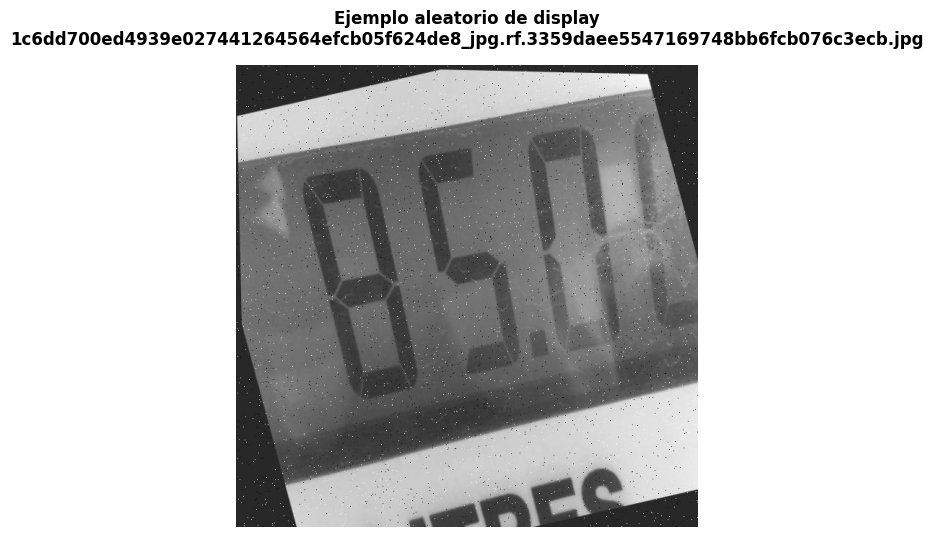

In [ ]:
import cv2
import matplotlib.pyplot as plt
import random
import os

# Configuración
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (8, 6)
TRAIN_PATH = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/train/images'

# Selección aleatoria
random_image = random.choice(os.listdir(TRAIN_PATH))
img_path = os.path.join(TRAIN_PATH, random_image)
img = cv2.imread(img_path)

# Visualización
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title(f"Ejemplo aleatorio de display\n{random_image}",
          pad=15, fontsize=12, weight='bold')
plt.show()

## 🔍 Selección de imágenes de test
Seleccionamos 20 imágenes aleatorias del conjunto de test para la evaluación comparativa:

In [ ]:
import os
import numpy as np
from IPython.display import display, HTML

# Configuración
TEST_PATH = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/test/images'
NUM_IMAGES = 20

# Selección aleatoria
test_images = os.listdir(TEST_PATH)
selected_images = np.random.choice(test_images, NUM_IMAGES, replace=False)

# Guardado de selección (para usar en todas las evaluaciones)
np.save('/content/selected_images.npy', selected_images)

# Visualización en tabla
html = "<h4>Imágenes seleccionadas:</h4><table><tr>"
for i, img_name in enumerate(selected_images):
    if i % 4 == 0 and i != 0:
        html += "</tr><tr>"
    html += f"<td style='text-align:center; padding:10px'>{img_name}</td>"
html += "</tr></table>"
display(HTML(html))

print(f"\n✅ {NUM_IMAGES} imágenes guardadas en '/content/selected_images.npy'")

239707f4afc926ed6b99d0570af619ddcc9acc92_jpg.rf.02efb9904ca296a199444ab2fa8310fc.jpg,d0183d179d58dd8157283feb50a7b2bd53b24005_jpg.rf.983881f57ac9c7c3ab09d4037d77ebc9.jpg,63_JPG.rf.c5275a4c16abba9fc7b5eee19ca31ae0.jpg,110fe91175bcab48f1aa01aee68a9554712f55ec_jpg.rf.ff2ba3c3867150aca501647166868773.jpg
16_JPG.rf.0511bad78016858d545177f7e324b097.jpg,198508aba9fa71fff7a356be7b0816d7b5d3ae7b_jpg.rf.ab95cb80ce1642e576d2d88d252abf42.jpg,1adcd452c57a2ded88b5b23fc8dc2a07ea6a9baf_jpg.rf.c252651abcd533961bd3cb5824a0ddd1.jpg,7f6c0991090642ce15ee5b79019157f104dcf99d_jpg.rf.f8455b55af680da7831f9a0a79be23ca.jpg
56_JPG.rf.9464f0d2d894fa294daef97b929477d9.jpg,b709749645b5c905d731a7f3725433b7c0360526_jpg.rf.470e57f787a1ac3a3ddc80311351a9fc.jpg,247af2172d1d58c76756b89c4b760f142e530828_jpg.rf.7e6ebf36c9b65c20ea91553fe0c99f98.jpg,22c83e3cc927a7d50dcaea9a12454a550dcf3812_jpg.rf.0aeffa93a87083173439b08988f7681d.jpg
2f4e7043428941035e5fec2ae92e9b6b6b14ddd7_jpg.rf.f370539e3c38cbb0ffdb988159ad72ab.jpg,1d53d603946be9cc710491177917b6b58377bcca_jpg.rf.862941677466a89047861b0aaf7f12f8.jpg,1035422f1a10a2bdadf40f0eb0031927d1f101c8_jpg.rf.4ba141d03469976e24f00bec9e7dee35.jpg,1c9aa921313f8b3b8dfde6130c91d9de4391570b_jpg.rf.bf731fb74d6949df8b88ea2dcee266db.jpg
8_JPG.rf.5e6f378411b50ff7947369fecf9ca53c.jpg,9e111802446b62b86aeffe911415ad28227caba7_jpg.rf.a9c983bb1aef13afd4888b3be6436a53.jpg,15518f179422ba96c17cbff1db58e5339775395a_jpg.rf.eb488f0d0adc38c3386d49f994424d6c.jpg,05aa08310f4ed9c7eff0ecd40e35feabb392dbe7_jpg.rf.6f99bc07ee4a96f1ca8ea62e31511a16.jpg



✅ 20 imágenes guardadas en '/content/selected_images.npy'


## Análisis con Google's Paligemma
Configuración del modelo multimodal para reconocimiento de displays de 7 segmentos:

In [ ]:
# Instalación silenciosa
!pip install -q -U transformers accelerate torch torchvision sentencepiece huggingface_hub

# Imports organizados
import torch
from transformers import AutoProcessor, AutoModelForVision2Seq
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from huggingface_hub import login

# Configuración de visualización
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (10, 6)

In [ ]:
#login("aquívaeltokendehugginface", add_to_git_credential=True)
print("✅ Autenticación HuggingFace completada")

✅ Autenticación HuggingFace completada


In [ ]:
# Configuración del dispositivo
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"🚀 Dispositivo de ejecución: {device.upper()}")

# Carga eficiente del modelo
model_id = "google/paligemma-3b-mix-224"

try:
    processor = AutoProcessor.from_pretrained(model_id)
    model = AutoModelForVision2Seq.from_pretrained(
        model_id,
        torch_dtype=torch.float16 if device=='cuda' else torch.float32
    ).to(device)
    print(f"✅ Modelo {model_id} cargado correctamente")
except Exception as e:
    print(f"❌ Error al cargar el modelo: {str(e)}")

🚀 Dispositivo de ejecución: CUDA


Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

✅ Modelo google/paligemma-3b-mix-224 cargado correctamente


## 📊 Procesamiento de las 20 imágenes seleccionadas
Análisis batch con prompt especializado para displays de 7 segmentos:

In [ ]:
import time
from tqdm.notebook import tqdm
import numpy as np
import os

# Cargar las 20 imágenes seleccionadas previamente
selected_images = np.load('/content/selected_images.npy')
test_dir = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/test/images'
image_paths = [os.path.join(test_dir, img) for img in selected_images]  # Rutas completas

# Verificación
print(f"📌 Se cargaron {len(image_paths)} imágenes para análisis:")
print("\n".join([f"→ {os.path.basename(p)}" for p in image_paths[:3]]) + "\n...")  # Muestra solo 3 para no saturar

def analyze_with_gemma(image_paths, prompt_question):
    results = []
    total_time = 0

    for img_path in tqdm(image_paths, desc="Procesando con Paligemma"):
        try:
            # 1. Carga de imagen
            start_time = time.time()
            image = Image.open(img_path).convert("RGB")
            load_time = time.time() - start_time

            # 2. Inferencia del modelo
            start_inference = time.time()
            inputs = processor(
                images=image,
                text=prompt_question,
                return_tensors="pt"
            ).to(device, torch.float16 if device=='cuda' else torch.float32)

            generated_ids = model.generate(**inputs, max_new_tokens=20)
            prediction = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]
            inference_time = time.time() - start_inference

            # 3. Guardado de resultados
            results.append({
                "image_name": os.path.basename(img_path),  # Nombre del archivo
                "image_path": img_path,
                "prediction": prediction.replace(prompt_question, "").strip(),
                "image_object": image,
                "load_time": load_time,
                "inference_time": inference_time,
                "total_time": load_time + inference_time
            })

        except Exception as e:
            print(f"⚠️ Error procesando {img_path}: {str(e)}")
            results.append({
                "image_name": os.path.basename(img_path),
                "image_path": img_path,
                "error": str(e),
                "load_time": 0,
                "inference_time": 0,
                "total_time": 0
            })

    # Métricas agregadas
    successful_runs = [r for r in results if "prediction" in r]
    avg_time = np.mean([r["total_time"] for r in successful_runs]) if successful_runs else 0

    print("\n" + "═"*50)
    print(f"📊 RESULTADOS GEMA:")
    print(f"✅ Procesadas: {len(successful_runs)}/{len(image_paths)} imágenes")
    print(f"⏱️ Tiempo promedio por imagen: {avg_time:.2f}s")
    print(f"⏱️ Tiempo total: {sum(r['total_time'] for r in results):.2f}s")
    print("═"*50)

    return results, avg_time

# Ejecución con el prompt especializado
PROMPT = "Identifica el número exacto mostrado en este display de 7 segmentos. Responde solo con el dígito numérico:"
gemma_results, gemma_avg_time = analyze_with_gemma(image_paths, PROMPT)

📌 Se cargaron 20 imágenes para análisis:
→ 239707f4afc926ed6b99d0570af619ddcc9acc92_jpg.rf.02efb9904ca296a199444ab2fa8310fc.jpg
→ d0183d179d58dd8157283feb50a7b2bd53b24005_jpg.rf.983881f57ac9c7c3ab09d4037d77ebc9.jpg
→ 63_JPG.rf.c5275a4c16abba9fc7b5eee19ca31ae0.jpg
...


Procesando con Paligemma:   0%|          | 0/20 [00:00<?, ?it/s]

You are passing both `text` and `images` to `PaliGemmaProcessor`. The processor expects special image tokens in the text, as many tokens as there are images per each text. It is recommended to add `<image>` tokens in the very beginning of your text. For this call, we will infer how many images each text has and add special tokens.
You are passing both `text` and `images` to `PaliGemmaProcessor`. The processor expects special image tokens in the text, as many tokens as there are images per each text. It is recommended to add `<image>` tokens in the very beginning of your text. For this call, we will infer how many images each text has and add special tokens.
You are passing both `text` and `images` to `PaliGemmaProcessor`. The processor expects special image tokens in the text, as many tokens as there are images per each text. It is recommended to add `<image>` tokens in the very beginning of your text. For this call, we will infer how many images each text has and add special tokens.
Y


══════════════════════════════════════════════════
📊 RESULTADOS GEMA:
✅ Procesadas: 20/20 imágenes
⏱️ Tiempo promedio por imagen: 0.32s
⏱️ Tiempo total: 6.33s
══════════════════════════════════════════════════


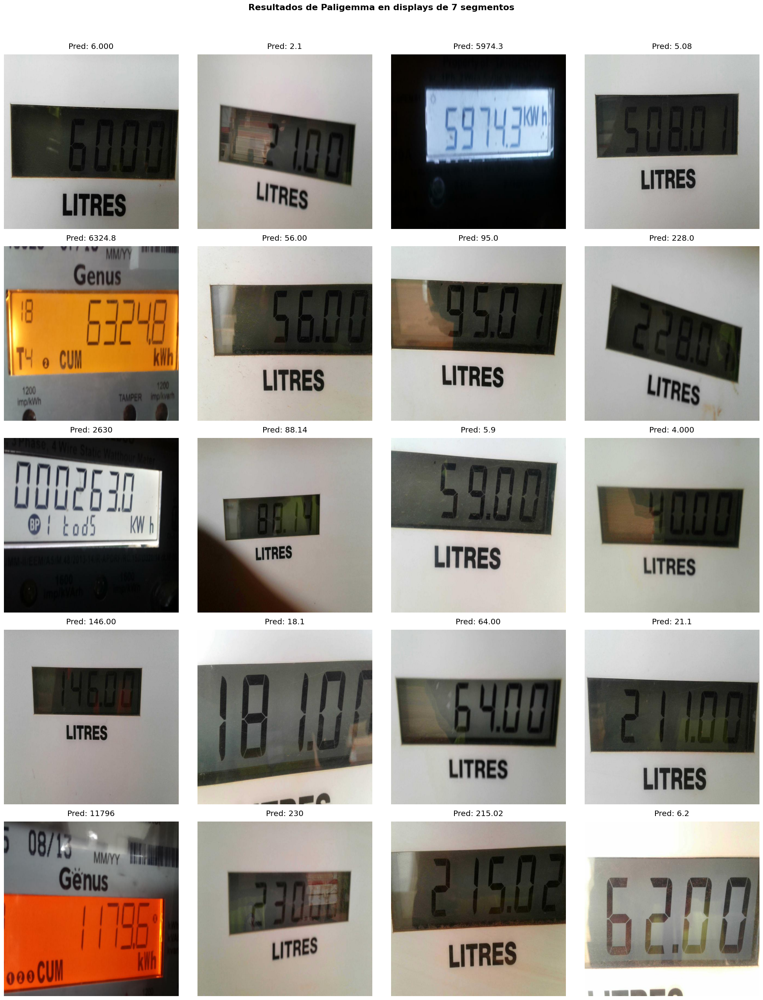

In [ ]:
# Configuración del grid
n_cols = 4
n_rows = int(np.ceil(len(gemma_results) / n_cols))

plt.figure(figsize=(20, 5*n_rows))
plt.suptitle("Resultados de Paligemma en displays de 7 segmentos",
             y=1.02, fontsize=16, weight='bold')

for i, result in enumerate(gemma_results):
    plt.subplot(n_rows, n_cols, i+1)

    try:
        if "image_object" in result:
            plt.imshow(result["image_object"])
            pred = result.get("prediction", "N/A")
            plt.title(f"Pred: {pred}", pad=10, color='black')
            plt.axis('off')
        else:
            error_msg = result.get('error', 'Error desconocido')[:30] + "..." if len(result.get('error', '')) > 30 else result.get('error', '')
            plt.text(0.5, 0.5, f"Error\n{error_msg}",
                    ha='center', va='center', color='#e74c3c', fontsize=10)
            plt.axis('off')
    except Exception as e:
        plt.text(0.5, 0.5, f"Error de visualización\n{str(e)[:30]}...",
                ha='center', va='center', color='#e74c3c')
        plt.axis('off')

plt.tight_layout()
plt.show()

## 🔍 Análisis con EasyOCR
Configuración del lector OCR para displays de 7 segmentos:

In [ ]:
!pip install easyocr --quiet
import easyocr
import cv2
import numpy as np
import time
from tqdm.notebook import tqdm
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
from IPython.display import display, HTML

# Configuración de visualización
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (10, 6)

In [ ]:
# Cargar las mismas 20 imágenes seleccionadas
selected_images = np.load('/content/selected_images.npy')
test_dir = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/test/images'
image_paths = [f"{test_dir}/{img}" for img in selected_images]

# Inicializar lector (solo una vez para medir tiempo real)
print("⏳ Inicializando EasyOCR...")
start_init = time.time()
reader = easyocr.Reader(['en'])  # English para dígitos
init_time = time.time() - start_init
print(f"✅ Lector inicializado en {init_time:.2f}s")

⏳ Inicializando EasyOCR...
✅ Lector inicializado en 4.89s


In [ ]:
def analyze_with_easyocr(image_paths):
    results = []
    total_process_time = 0

    for img_path in tqdm(image_paths, desc="Procesando imágenes"):
        try:
            # 1. Carga y preprocesamiento
            start_time = time.time()
            img_cv = cv2.imread(img_path)
            load_time = time.time() - start_time

            # 2. Inferencia OCR
            start_inference = time.time()
            ocr_results = reader.readtext(img_cv)
            inference_time = time.time() - start_inference

            # 3. Procesar resultados
            predictions = [text for (_, text, _) in ocr_results]
            combined_pred = " ".join(predictions) if predictions else "N/A"

            results.append({
                "image_name": img_path.split("/")[-1],
                "predictions": predictions,
                "combined_pred": combined_pred,
                "image_object": Image.fromarray(cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB)),
                "load_time": load_time,
                "inference_time": inference_time,
                "total_time": load_time + inference_time,
                "details": ocr_results  # Guardar resultados crudos
            })

        except Exception as e:
            print(f"⚠️ Error procesando {img_path}: {str(e)}")
            results.append({
                "image_name": img_path.split("/")[-1],
                "error": str(e),
                "total_time": 0
            })

    # Métricas
    successful_runs = [r for r in results if "predictions" in r]
    avg_time = np.mean([r["total_time"] for r in successful_runs]) if successful_runs else 0

    print("\n" + "="*60)
    print(f"📊 Resultados EasyOCR (20 imágenes)")
    print(f"⏱️ Tiempo inicialización: {init_time:.2f}s")
    print(f"⏱️ Tiempo promedio/inferencia: {avg_time:.2f}s")
    print(f"⏱️ Tiempo total: {sum(r['total_time'] for r in results):.2f}s")
    print("="*60)

    return results, avg_time

# Ejecución
easyocr_results, easyocr_avg_time = analyze_with_easyocr(image_paths)


Procesando imágenes:   0%|          | 0/20 [00:00<?, ?it/s]


📊 Resultados EasyOCR (20 imágenes)
⏱️ Tiempo inicialización: 4.89s
⏱️ Tiempo promedio/inferencia: 0.17s
⏱️ Tiempo total: 3.44s


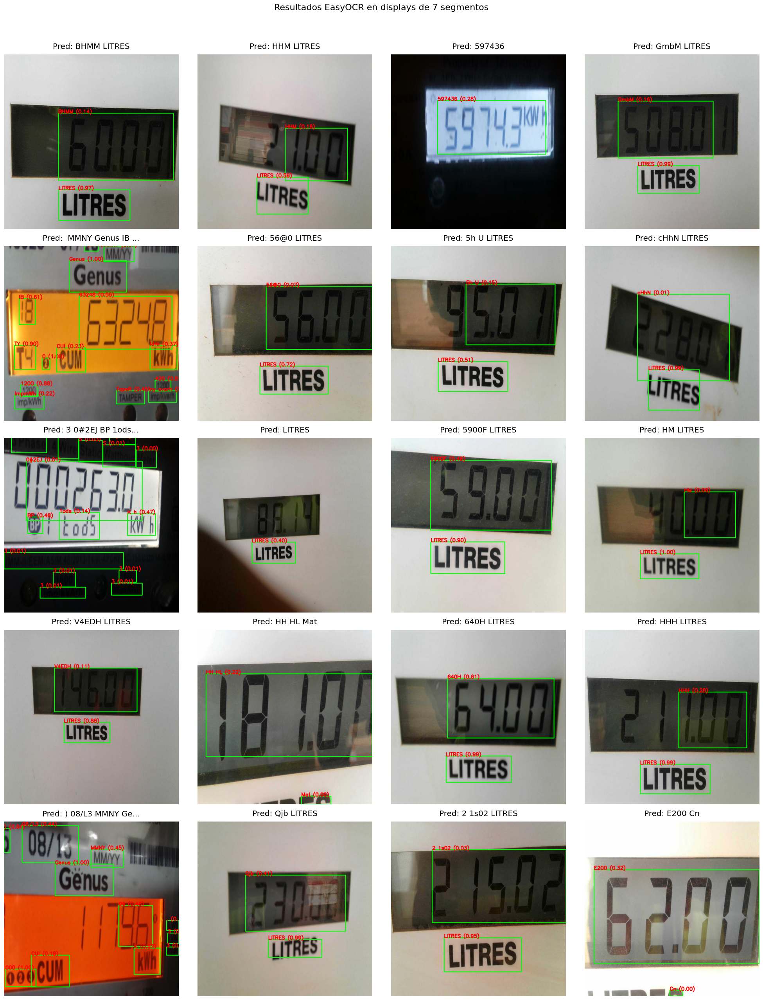

In [ ]:
# Configurar grid
n_cols = 4
n_rows = int(np.ceil(len(easyocr_results) / n_cols))

plt.figure(figsize=(20, 5*n_rows))
plt.suptitle("Resultados EasyOCR en displays de 7 segmentos", fontsize=16, y=1.02)

for i, result in enumerate(easyocr_results):
    plt.subplot(n_rows, n_cols, i+1)

    if "image_object" in result:
        # Mostrar imagen con bounding boxes
        img_draw = np.array(result["image_object"].copy())
        for (bbox, text, prob) in result.get("details", []):
            (tl, tr, br, bl) = np.array(bbox).astype(int)
            cv2.rectangle(img_draw, tuple(tl), tuple(br), (0, 255, 0), 2)
            cv2.putText(img_draw, f"{text} ({prob:.2f})", tuple(tl),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

        plt.imshow(img_draw)
        title = result["combined_pred"][:15] + "..." if len(result["combined_pred"]) > 15 else result["combined_pred"]
        plt.title(f"Pred: {title}", pad=10, color='black')
        plt.axis('off')
    else:
        plt.text(0.5, 0.5, f"Error\n{result.get('error', '')[:30]}...",
                ha='center', va='center', color='red')
        plt.axis('off')

plt.tight_layout()
plt.show()


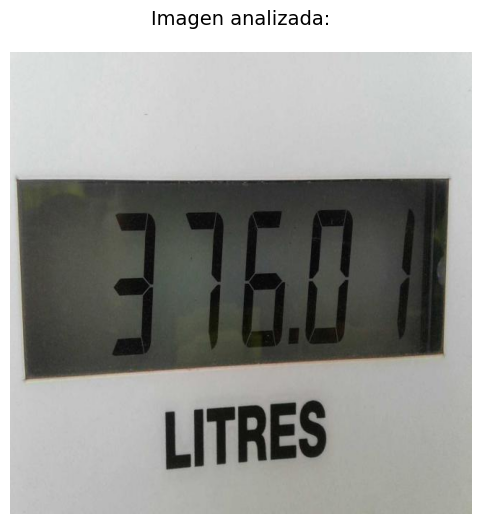


🔍 OCR directo (imagen completa): 3768 LItrES
🧩 OCR por recortes YOLO: 1870H2


In [ ]:
import cv2
import easyocr
import os
import numpy as np
import matplotlib.pyplot as plt

# === CONFIGURACIÓN ===
img_path = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/train/images/005fc43f13dfef916914b17ef7ec7deb932bb33b_jpg.rf.16551153a191edf603fb8c3b8d204082.jpg'
label_path = img_path.replace('/images/', '/labels/').replace('.jpg', '.txt')  # ajusta si usas .png
reader = easyocr.Reader(['en'], gpu=True)

# === MOSTRAR IMAGEN ORIGINAL ===
img = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir a RGB para matplotlib

plt.figure(figsize=(10, 6))
plt.imshow(img_rgb)
plt.axis('off')
plt.title(f"Imagen analizada:", pad=20, fontsize=14)
plt.show()

# === 1. OCR DIRECTO sobre imagen completa ===
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ocr_full = reader.readtext(gray, detail=0, paragraph=False)
print("\n🔍 OCR directo (imagen completa):", ' '.join(ocr_full))

# === 2. OCR por recortes YOLO ===
h_img, w_img = img.shape[:2]
boxes = []

# Leer etiquetas YOLOv11
with open(label_path, 'r') as f:
    for line in f:
        cls, cx, cy, w, h = map(float, line.strip().split())
        x1 = int((cx - w / 2) * w_img)
        y1 = int((cy - h / 2) * h_img)
        x2 = int((cx + w / 2) * w_img)
        y2 = int((cy + h / 2) * h_img)
        boxes.append((cls, x1, y1, x2, y2))

# Ordenar de izquierda a derecha
boxes = sorted(boxes, key=lambda b: b[1])

# OCR individual por box
ocr_yolo = ''
for cls, x1, y1, x2, y2 in boxes:
    crop = img[y1:y2, x1:x2]
    pred = reader.readtext(crop, detail=0, paragraph=False)
    char = pred[0] if pred else ('.' if int(cls) == 10 else str(int(cls)))
    ocr_yolo += char

print("🧩 OCR por recortes YOLO:", ocr_yolo)


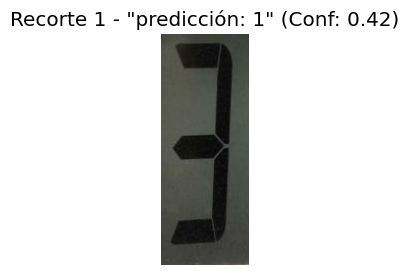

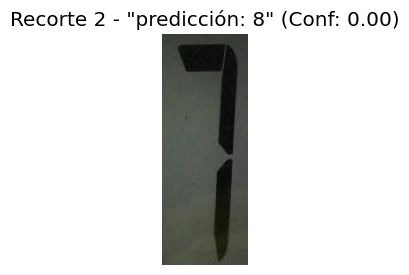

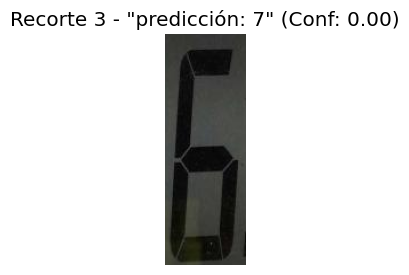

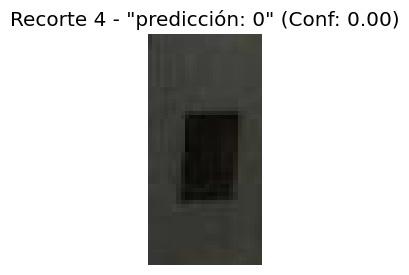

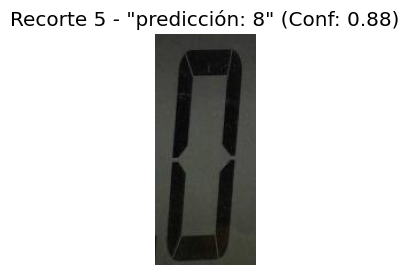

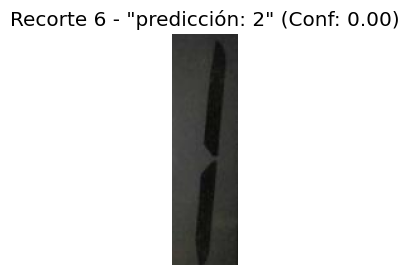

In [ ]:
import cv2
import easyocr
import matplotlib.pyplot as plt
import numpy as np

# Ruta de la imagen y etiquetas
img_path = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/train/images/005fc43f13dfef916914b17ef7ec7deb932bb33b_jpg.rf.16551153a191edf603fb8c3b8d204082.jpg'
label_path = img_path.replace('/images/', '/labels/').replace('.jpg', '.txt')

# Carga EasyOCR con allowlist para solo números y punto
reader = easyocr.Reader(['en'], gpu=True)

# Carga imagen y dimensiones
img = cv2.imread(img_path)
h_img, w_img = img.shape[:2]

# Leer cajas YOLOv11
boxes = []
with open(label_path, 'r') as f:
    for line in f:
        cls, cx, cy, w, h = map(float, line.strip().split())
        x1 = int((cx - w / 2) * w_img)
        y1 = int((cy - h / 2) * h_img)
        x2 = int((cx + w / 2) * w_img)
        y2 = int((cy + h / 2) * h_img)
        boxes.append((cls, x1, y1, x2, y2))

# Ordenar boxes de izquierda a derecha
boxes = sorted(boxes, key=lambda b: b[1])

# Mostrar cada recorte con su predicción y confianza
for i, (cls, x1, y1, x2, y2) in enumerate(boxes):
    crop = img[y1:y2, x1:x2]

    # === Preprocesamiento ===
    gray = cv2.cvtColor(crop, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    kernel = np.ones((2, 2), np.uint8)
    clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    zoomed = cv2.resize(clean, None, fx=2, fy=2, interpolation=cv2.INTER_LINEAR)

    # OCR con detalle y allowlist
    results = reader.readtext(zoomed, detail=1, paragraph=False, allowlist='0123456789.')

    if results:
        _, text, conf = results[0]
        detected_char = ''.join(c for c in text if c.isdigit() or c == '.')
    else:
        detected_char = '.' if int(cls) == 10 else str(int(cls))
        conf = 0.0

    # Mostrar imagen con resultado
    plt.figure(figsize=(3, 3))
    plt.imshow(cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
    plt.title(f'Recorte {i+1} - "predicción: {detected_char}" (Conf: {conf:.2f})')
    plt.axis('off')
    plt.show()



## 🎯 Análisis con YOLOv11
Evaluación del modelo personalizado para detección de dígitos en displays:

In [ ]:
!pip install ultralytics --quiet
import time
import cv2
import numpy as np
from ultralytics import YOLO
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import pandas as pd
from IPython.display import display, HTML

# Cargar las 20 imágenes seleccionadas
selected_images = np.load('/content/selected_images.npy')
test_dir = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/test/images'
image_paths = [f"{test_dir}/{img}" for img in selected_images]

# Configuración de visualización
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (10, 6)

### 🔄 Entrenamiento del modelo
Configuración del proceso de entrenamiento para detección de dígitos:

In [ ]:
# Verificar estructura del dataset
!cat '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml'

# Verificar estructura del dataset
!cat '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml'

# Ruta del modelo entrenado
model_path = '/content/gemma-ocr-displays/yolo-runs/char-detector/weights/best.pt'

# Verificar si el modelo existe
if os.path.exists(model_path):
    print("✅ Modelo ya entrenado encontrado. Saltando entrenamiento...")
    model = YOLO(model_path)
else:
    print("🚨 Modelo no encontrado. Iniciando entrenamiento...")
    start_train = time.time()
    # Entrenar nuevo modelo
    model = YOLO('yolov8n.yaml')  # Modelo base sin preentrenar

    model.train(
        data='/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml',
        epochs=50,
        imgsz=224,
        batch=16,
        name='char-detector',
        project='/content/gemma-ocr-displays/yolo-runs',
        device='0' if torch.cuda.is_available() else 'cpu'
    )

    print("✅ Entrenamiento completado. Cargando mejor modelo...")
    model = YOLO(model_path)  # Cargar el mejor modelo

    train_time = (time.time() - start_train) / 60
    print(f"\n✅ Entrenamiento completado en {train_time:.2f} minutos")

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 11
names: ['.', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

roboflow:
  workspace: ridwanexploration
  project: 7-segment-display-gxhnj-gldg5
  version: 1
  license: Public Domain
  url: https://universe.roboflow.com/ridwanexploration/7-segment-display-gxhnj-gldg5/dataset/1train: ../train/images
val: ../valid/images
test: ../test/images

nc: 11
names: ['.', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

roboflow:
  workspace: ridwanexploration
  project: 7-segment-display-gxhnj-gldg5
  version: 1
  license: Public Domain
  url: https://universe.roboflow.com/ridwanexploration/7-segment-display-gxhnj-gldg5/dataset/1✅ Modelo ya entrenado encontrado. Saltando entrenamiento...


### 📊 Métricas de validación
Resultados del modelo en el conjunto de validación:

In [ ]:
# Validación
metrics = model.val(
    data='/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml',
    split='val',
    imgsz=224,
    conf=0.4,
    iou=0.5
)



Ultralytics 8.3.145 🚀 Python-3.11.12 torch-2.7.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n summary (fused): 72 layers, 3,007,793 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 12.5±2.2 MB/s, size: 25.9 KB)


val: Scanning /content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/valid/labels.cache... 168 images, 0 backgrounds, 0 corrupt: 100%|██████████| 168/168 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04<00:00,  2.49it/s]


                   all        168        913      0.908      0.838      0.874      0.535
                     .        160        164       0.66      0.415       0.52      0.225
                     0        140        256      0.981      0.984      0.981      0.632
                     1         70         92      0.724      0.598      0.633      0.313
                     2         55         68      0.829      0.853      0.885       0.54
                     3         51         60      0.982      0.933      0.953      0.607
                     4         40         45      0.938          1      0.964      0.572
                     5         55         61      0.872      0.672        0.8      0.467
                     6         49         55          1      0.982      0.991      0.659
                     7         35         41          1      0.951      0.976      0.593
                     8         36         39          1      0.923      0.961      0.658
                     

### 🚀 Carga del modelo entrenado
Preparación para inferencia en las 20 imágenes de test:

In [ ]:
# Cargar el mejor modelo obtenido
model_path = '/content/gemma-ocr-displays/yolo-runs/char-detector/weights/best.pt'

start_load = time.time()
model = YOLO(model_path)
load_time = time.time() - start_load

print(f"✅ Modelo YOLOv11 cargado en {load_time:.2f}s")
print(f"🔍 Clases reconocidas: {model.names}")

# Cargar las 20 imágenes seleccionadas
selected_images = np.load('/content/selected_images.npy')
test_dir = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/test/images'
image_paths = [f"{test_dir}/{img}" for img in selected_images]

✅ Modelo YOLOv11 cargado en 0.12s
🔍 Clases reconocidas: {0: '.', 1: '0', 2: '1', 3: '2', 4: '3', 5: '4', 6: '5', 7: '6', 8: '7', 9: '8', 10: '9'}


### 🔍 Inferencia en imágenes de test
Procesamiento de las 20 imágenes con medición de tiempos:

In [ ]:
def analyze_with_yolo(image_paths, conf_threshold=0.4, iou_threshold=0.5):
    results = []
    total_time = 0

    for img_path in tqdm(image_paths, desc="Procesando imágenes con YOLOv11"):
        try:
            # 1. Carga de imagen
            start_time = time.time()
            img = cv2.imread(img_path)
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            load_time = time.time() - start_time

            # 2. Inferencia YOLO
            start_inference = time.time()
            yolo_results = model(img_rgb, conf=conf_threshold, iou=iou_threshold)[0]
            inference_time = time.time() - start_inference

            # 3. Procesar detecciones
            boxes = yolo_results.boxes
            chars = []

            for b in boxes:
                cls_id = int(b.cls[0])
                char = model.names[cls_id]
                x1 = int(b.xyxy[0][0])
                chars.append((x1, char))

            # Filtrar dígitos muy cercanos (duplicados)
            filtered = []
            min_dist_x = 10  # Ajustar según espaciado de dígitos

            for x1, char in sorted(chars):
                if not filtered or abs(x1 - filtered[-1][0]) > min_dist_x:
                    filtered.append((x1, char))

            detected = ''.join(c for _, c in filtered)

            # Guardar resultados
            results.append({
                "image_name": os.path.basename(img_path),
                "prediction": detected,
                "image_object": img_rgb,
                "annotated_image": yolo_results.plot(),  # Imagen con bboxes
                "load_time": load_time,
                "inference_time": inference_time,
                "total_time": load_time + inference_time
            })

        except Exception as e:
            print(f"⚠️ Error en {os.path.basename(img_path)}: {str(e)}")
            results.append({
                "image_name": os.path.basename(img_path),
                "error": str(e),
                "total_time": 0
            })

    # Métricas agregadas
    successful_runs = [r for r in results if "prediction" in r]
    avg_time = np.mean([r["total_time"] for r in successful_runs]) if successful_runs else 0

    print("\n" + "="*60)
    print(f"📊 RESULTADOS YOLOv11 (20 imágenes)")
    print(f"⏱️ Tiempo carga modelo: {load_time:.2f}s")
    print(f"⏱️ Tiempo promedio/inferencia: {avg_time:.2f}s")
    print(f"⏱️ Tiempo total: {sum(r['total_time'] for r in results):.2f}s")
    print("="*60)

    return results, avg_time

In [ ]:
# Ejecutar análisis en las 20 imágenes
yolo_results, yolo_avg_time = analyze_with_yolo(image_paths)

Procesando imágenes con YOLOv11:   0%|          | 0/20 [00:00<?, ?it/s]


0: 224x224 3 0s, 1 6, 10.4ms
Speed: 1.6ms preprocess, 10.4ms inference, 2.2ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 2 0s, 1 1, 12.6ms
Speed: 1.3ms preprocess, 12.6ms inference, 2.3ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 3, 1 4, 1 5, 1 7, 1 9, 23.9ms
Speed: 1.2ms preprocess, 23.9ms inference, 3.3ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 2 0s, 1 1, 1 8, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 2.6ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 2, 1 3, 1 4, 1 6, 1 8, 11.1ms
Speed: 1.2ms preprocess, 11.1ms inference, 2.2ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 2 0s, 1 5, 1 6, 10.9ms
Speed: 1.2ms preprocess, 10.9ms inference, 2.2ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 1 0, 1 1, 1 9, 9.4ms
Speed: 1.0ms preprocess, 9.4ms inference, 2.0ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 1 0, 1 1, 2 2s, 1 8, 11.3ms
Speed:

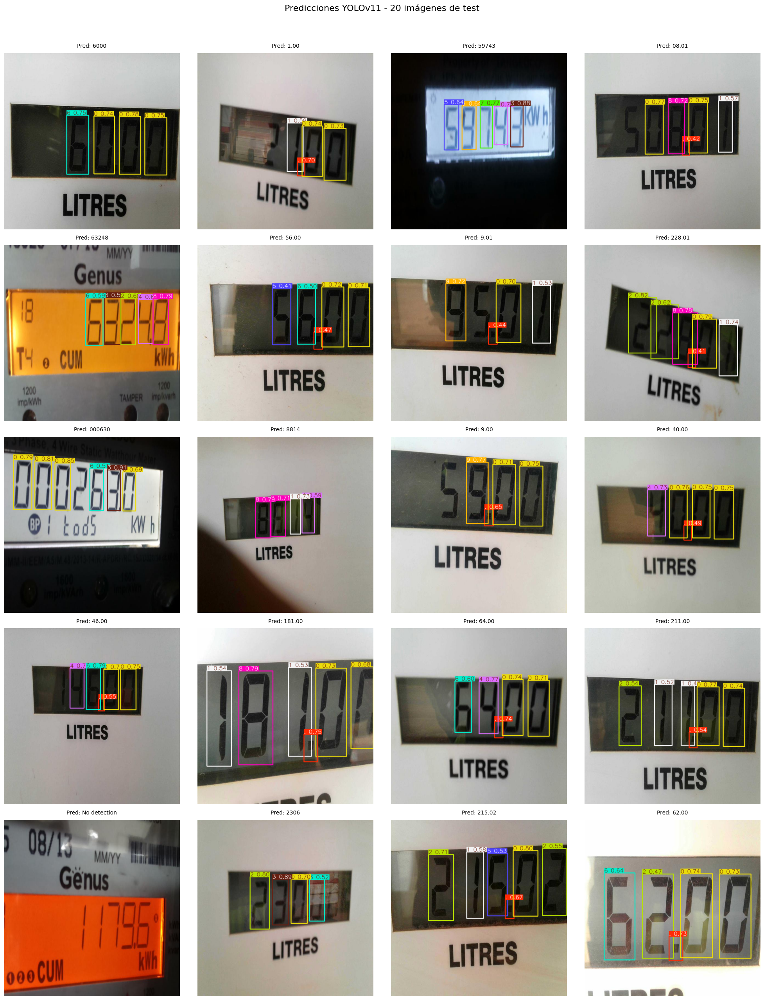

In [ ]:
# Configurar grid de resultados
n_cols = 4
n_rows = int(np.ceil(len(yolo_results) / n_cols))

plt.figure(figsize=(20, 5*n_rows))
plt.suptitle("Predicciones YOLOv11 - 20 imágenes de test", fontsize=16, y=1.02)

for i, result in enumerate(yolo_results):
    plt.subplot(n_rows, n_cols, i+1)

    if "annotated_image" in result:
        plt.imshow(result["annotated_image"])
        title = result["prediction"] if result["prediction"] else "No detection"
        plt.title(f"Pred: {title}", pad=10, color='black', fontsize=10)
        plt.axis('off')
    else:
        plt.text(0.5, 0.5, f"Error\n{result.get('error', '')[:30]}...",
                ha='center', va='center', color='red')
        plt.axis('off')

plt.tight_layout()
plt.show()

## 🎯 Análisis con YOLOv11 Preentrenado
Evaluación del modelo personalizado usando de partida un modelo preentrenado para detección de dígitos en displays:

In [ ]:
# Verificar estructura del dataset
!cat '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml'

# Ruta del modelo entrenado
model_path = '/content/gemma-ocr-displays/yolo-preentrenado-runs/char-detector/weights/best.pt'

# Verificar si el modelo existe
if os.path.exists(model_path):
    print("✅ Modelo ya entrenado encontrado. Saltando entrenamiento...")
    model = YOLO(model_path)
else:
    print("🚨 Modelo no encontrado. Iniciando entrenamiento...")
    start_train = time.time()
    # Entrenar nuevo modelo
    model = YOLO('yolov8n.pt')  # Modelo base preentrenado

    model.train(
        data='/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml',
        epochs=50,
        imgsz=224,
        batch=16,
        name='char-detector',
        project='/content/gemma-ocr-displays/yolo-preentrenado-runs',
        device='0' if torch.cuda.is_available() else 'cpu'
    )

    print("✅ Entrenamiento completado. Cargando mejor modelo...")
    model = YOLO(model_path)  # Cargar el mejor modelo

    train_time = (time.time() - start_train) / 60
    print(f"\n✅ Entrenamiento completado en {train_time:.2f} minutos")

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 11
names: ['.', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

roboflow:
  workspace: ridwanexploration
  project: 7-segment-display-gxhnj-gldg5
  version: 1
  license: Public Domain
  url: https://universe.roboflow.com/ridwanexploration/7-segment-display-gxhnj-gldg5/dataset/1✅ Modelo ya entrenado encontrado. Saltando entrenamiento...


In [ ]:
# Validación
metrics = model.val(
    data='/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml',
    split='val',
    imgsz=224,
    conf=0.4,
    iou=0.5
)


Ultralytics 8.3.145 🚀 Python-3.11.12 torch-2.7.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,793 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 565.4±167.1 MB/s, size: 25.4 KB)


val: Scanning /content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/valid/labels.cache... 168 images, 0 backgrounds, 0 corrupt: 100%|██████████| 168/168 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:02<00:00,  3.79it/s]


                   all        168        913      0.928      0.908       0.91      0.565
                     .        160        164      0.731      0.482        0.6      0.243
                     0        140        256      0.981      0.988      0.991      0.659
                     1         70         92      0.648      0.641      0.551      0.284
                     2         55         68      0.944      0.985      0.979       0.61
                     3         51         60      0.967      0.983      0.987      0.667
                     4         40         45      0.957          1       0.97      0.623
                     5         55         61      0.983      0.934      0.965      0.594
                     6         49         55          1          1      0.995      0.632
                     7         35         41          1      0.976      0.987      0.601
                     8         36         39          1          1      0.995      0.672
                     

In [ ]:
# Cargar el mejor modelo obtenido
model_path = '/content/gemma-ocr-displays/yolo-preentrenado-runs/char-detector/weights/best.pt'

start_load = time.time()
model = YOLO(model_path)
load_time = time.time() - start_load

print(f"✅ Modelo YOLOv11 cargado en {load_time:.2f}s")
print(f"🔍 Clases reconocidas: {model.names}")

# Cargar las 20 imágenes seleccionadas
selected_images = np.load('/content/selected_images.npy')
test_dir = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/test/images'
image_paths = [f"{test_dir}/{img}" for img in selected_images]

✅ Modelo YOLOv11 cargado en 0.10s
🔍 Clases reconocidas: {0: '.', 1: '0', 2: '1', 3: '2', 4: '3', 5: '4', 6: '5', 7: '6', 8: '7', 9: '8', 10: '9'}


In [ ]:
def analyze_with_yolo(image_paths, conf_threshold=0.4, iou_threshold=0.5):
    results = []
    total_time = 0

    for img_path in tqdm(image_paths, desc="Procesando imágenes con YOLOv11"):
        try:
            # 1. Carga de imagen
            start_time = time.time()
            img = cv2.imread(img_path)
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            load_time = time.time() - start_time

            # 2. Inferencia YOLO
            start_inference = time.time()
            yolo_results = model(img_rgb, conf=conf_threshold, iou=iou_threshold)[0]
            inference_time = time.time() - start_inference

            # 3. Procesar detecciones
            boxes = yolo_results.boxes
            chars = []

            for b in boxes:
                cls_id = int(b.cls[0])
                char = model.names[cls_id]
                x1 = int(b.xyxy[0][0])
                chars.append((x1, char))

            # Filtrar dígitos muy cercanos (duplicados)
            filtered = []
            min_dist_x = 10  # Ajustar según espaciado de dígitos

            for x1, char in sorted(chars):
                if not filtered or abs(x1 - filtered[-1][0]) > min_dist_x:
                    filtered.append((x1, char))

            detected = ''.join(c for _, c in filtered)

            # Guardar resultados
            results.append({
                "image_name": os.path.basename(img_path),
                "prediction": detected,
                "image_object": img_rgb,
                "annotated_image": yolo_results.plot(),  # Imagen con bboxes
                "load_time": load_time,
                "inference_time": inference_time,
                "total_time": load_time + inference_time
            })

        except Exception as e:
            print(f"⚠️ Error en {os.path.basename(img_path)}: {str(e)}")
            results.append({
                "image_name": os.path.basename(img_path),
                "error": str(e),
                "total_time": 0
            })

    # Métricas agregadas
    successful_runs = [r for r in results if "prediction" in r]
    avg_time = np.mean([r["total_time"] for r in successful_runs]) if successful_runs else 0

    print("\n" + "="*60)
    print(f"📊 RESULTADOS YOLOv11 (20 imágenes)")
    print(f"⏱️ Tiempo carga modelo: {load_time:.2f}s")
    print(f"⏱️ Tiempo promedio/inferencia: {avg_time:.2f}s")
    print(f"⏱️ Tiempo total: {sum(r['total_time'] for r in results):.2f}s")
    print("="*60)

    return results, avg_time

In [ ]:
# Ejecutar análisis en las 20 imágenes
yolo_results, yolo_avg_time = analyze_with_yolo(image_paths)

Procesando imágenes con YOLOv11:   0%|          | 0/20 [00:00<?, ?it/s]


0: 224x224 1 ., 3 0s, 1 6, 8.7ms
Speed: 1.2ms preprocess, 8.7ms inference, 1.8ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 2 0s, 1 1, 1 2, 22.4ms
Speed: 1.0ms preprocess, 22.4ms inference, 2.6ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 3, 1 4, 1 5, 1 7, 1 9, 26.4ms
Speed: 1.0ms preprocess, 26.4ms inference, 8.8ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 2 0s, 1 1, 1 5, 1 8, 14.6ms
Speed: 1.0ms preprocess, 14.6ms inference, 1.7ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 2, 1 3, 1 4, 1 6, 2 8s, 19.0ms
Speed: 1.0ms preprocess, 19.0ms inference, 2.1ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 2 0s, 1 5, 1 6, 19.5ms
Speed: 2.3ms preprocess, 19.5ms inference, 1.8ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 1 0, 1 1, 1 5, 1 9, 20.6ms
Speed: 2.3ms preprocess, 20.6ms inference, 1.8ms postprocess per image at shape (1, 3, 224, 224)

0: 224x224 1 ., 1 0, 1 1, 2 2s, 1 

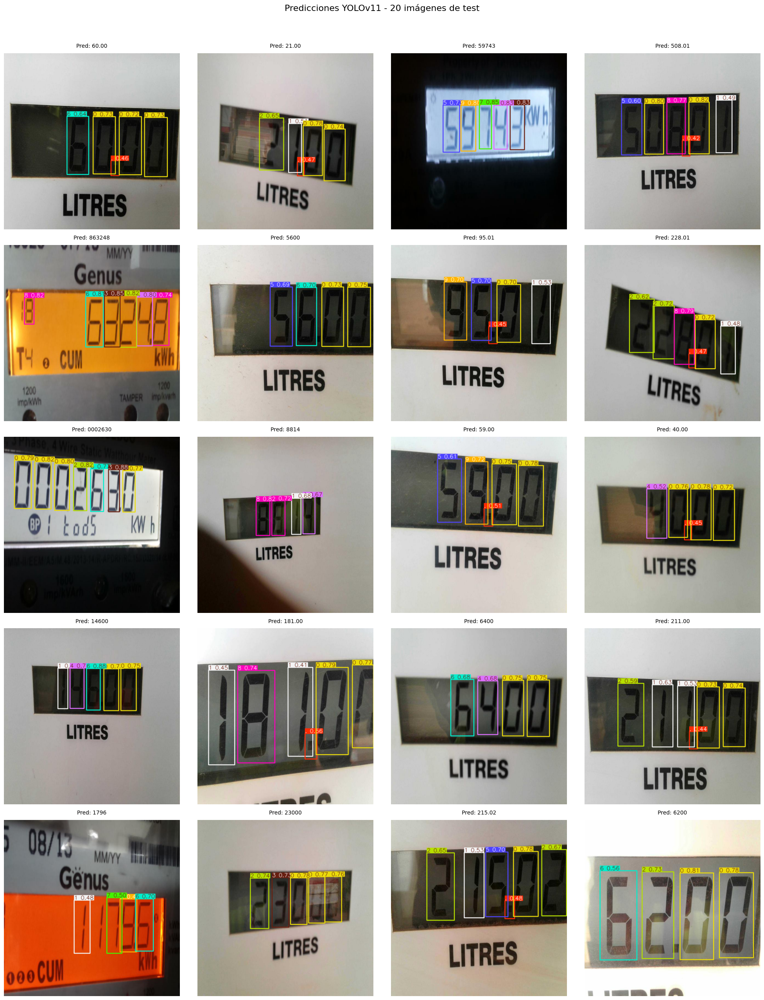

In [ ]:

# Configurar grid de resultados
n_cols = 4
n_rows = int(np.ceil(len(yolo_results) / n_cols))

plt.figure(figsize=(20, 5*n_rows))
plt.suptitle("Predicciones YOLOv11 - 20 imágenes de test", fontsize=16, y=1.02)

for i, result in enumerate(yolo_results):
    plt.subplot(n_rows, n_cols, i+1)

    if "annotated_image" in result:
        plt.imshow(result["annotated_image"])
        title = result["prediction"] if result["prediction"] else "No detection"
        plt.title(f"Pred: {title}", pad=10, color='black', fontsize=10)
        plt.axis('off')
    else:
        plt.text(0.5, 0.5, f"Error\n{result.get('error', '')[:30]}...",
                ha='center', va='center', color='red')
        plt.axis('off')

plt.tight_layout()
plt.show()

## 🎯 Análisis con YOLOv11 MUY entrenado
Evaluación del modelo personalizado usando un modelo propio muy entrenado para detección de dígitos en displays:

In [ ]:
# Verificar estructura del dataset
!cat '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml'

# Ruta del modelo entrenado
model_path = '/content/gemma-ocr-displays/yolo-muyentrenado-runs/char-detector/weights/best.pt'

# Verificar si el modelo existe
if os.path.exists(model_path):
    print("✅ Modelo ya entrenado encontrado. Saltando entrenamiento...")
    model = YOLO(model_path)
else:
    print("🚨 Modelo no encontrado. Iniciando entrenamiento...")
    start_train = time.time()
    # Entrenar nuevo modelo
    model = YOLO('yolov8n.pt')  # Modelo base preentrenado

    model.train(
        data='/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml',
        epochs=100,
        imgsz=320,
        batch=16,
        name='char-detector',
        project='/content/gemma-ocr-displays/yolo-muyentrenado-runs',
        device='0' if torch.cuda.is_available() else 'cpu'
    )

    print("✅ Entrenamiento completado. Cargando mejor modelo...")
    model = YOLO(model_path)  # Cargar el mejor modelo

    train_time = (time.time() - start_train) / 60
    print(f"\n✅ Entrenamiento completado en {train_time:.2f} minutos")

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 11
names: ['.', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

roboflow:
  workspace: ridwanexploration
  project: 7-segment-display-gxhnj-gldg5
  version: 1
  license: Public Domain
  url: https://universe.roboflow.com/ridwanexploration/7-segment-display-gxhnj-gldg5/dataset/1✅ Modelo ya entrenado encontrado. Saltando entrenamiento...


In [ ]:
# Validación
metrics = model.val(
    data='/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/data.yaml',
    split='val',
    imgsz=320,
    conf=0.4,
    iou=0.5
)


Ultralytics 8.3.145 🚀 Python-3.11.12 torch-2.7.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,793 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 465.5±95.1 MB/s, size: 22.8 KB)


val: Scanning /content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/valid/labels.cache... 168 images, 0 backgrounds, 0 corrupt: 100%|██████████| 168/168 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03<00:00,  3.40it/s]


                   all        168        913      0.921      0.892      0.905      0.567
                     .        160        164      0.686      0.506      0.579      0.236
                     0        140        256      0.984      0.988      0.988      0.655
                     1         70         92      0.629      0.424      0.495      0.246
                     2         55         68      0.985      0.985      0.979      0.641
                     3         51         60      0.967      0.983       0.98      0.674
                     4         40         45      0.957          1      0.983       0.63
                     5         55         61          1      0.951      0.975      0.601
                     6         49         55      0.982          1      0.995      0.645
                     7         35         41          1          1      0.995      0.618
                     8         36         39      0.974      0.974      0.986      0.644
                     

In [ ]:
# Cargar el mejor modelo obtenido
model_path = '/content/gemma-ocr-displays/yolo-muyentrenado-runs/char-detector/weights/best.pt'

start_load = time.time()
model = YOLO(model_path)
load_time = time.time() - start_load

print(f"✅ Modelo YOLOv11 cargado en {load_time:.2f}s")
print(f"🔍 Clases reconocidas: {model.names}")

# Cargar las 20 imágenes seleccionadas
selected_images = np.load('/content/selected_images.npy')
test_dir = '/content/gemma-ocr-displays/imagenes/1_seven_segment_yolov11/test/images'
image_paths = [f"{test_dir}/{img}" for img in selected_images]

✅ Modelo YOLOv11 cargado en 0.06s
🔍 Clases reconocidas: {0: '.', 1: '0', 2: '1', 3: '2', 4: '3', 5: '4', 6: '5', 7: '6', 8: '7', 9: '8', 10: '9'}


In [ ]:
def analyze_with_yolo(image_paths, conf_threshold=0.4, iou_threshold=0.5):
    results = []
    total_time = 0

    for img_path in tqdm(image_paths, desc="Procesando imágenes con YOLOv11"):
        try:
            # 1. Carga de imagen
            start_time = time.time()
            img = cv2.imread(img_path)
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            load_time = time.time() - start_time

            # 2. Inferencia YOLO
            start_inference = time.time()
            yolo_results = model(img_rgb, conf=conf_threshold, iou=iou_threshold)[0]
            inference_time = time.time() - start_inference

            # 3. Procesar detecciones
            boxes = yolo_results.boxes
            chars = []

            for b in boxes:
                cls_id = int(b.cls[0])
                char = model.names[cls_id]
                x1 = int(b.xyxy[0][0])
                chars.append((x1, char))

            # Filtrar dígitos muy cercanos (duplicados)
            filtered = []
            min_dist_x = 10  # Ajustar según espaciado de dígitos

            for x1, char in sorted(chars):
                if not filtered or abs(x1 - filtered[-1][0]) > min_dist_x:
                    filtered.append((x1, char))

            detected = ''.join(c for _, c in filtered)

            # Guardar resultados
            results.append({
                "image_name": os.path.basename(img_path),
                "prediction": detected,
                "image_object": img_rgb,
                "annotated_image": yolo_results.plot(),  # Imagen con bboxes
                "load_time": load_time,
                "inference_time": inference_time,
                "total_time": load_time + inference_time
            })

        except Exception as e:
            print(f"⚠️ Error en {os.path.basename(img_path)}: {str(e)}")
            results.append({
                "image_name": os.path.basename(img_path),
                "error": str(e),
                "total_time": 0
            })

    # Métricas agregadas
    successful_runs = [r for r in results if "prediction" in r]
    avg_time = np.mean([r["total_time"] for r in successful_runs]) if successful_runs else 0

    print("\n" + "="*60)
    print(f"📊 RESULTADOS YOLOv11 (20 imágenes)")
    print(f"⏱️ Tiempo carga modelo: {load_time:.2f}s")
    print(f"⏱️ Tiempo promedio/imagen: {avg_time:.2f}s")
    print(f"⏱️ Tiempo total: {sum(r['total_time'] for r in results):.2f}s")
    print("="*60)

    return results, avg_time

In [ ]:
# Ejecutar análisis en las 20 imágenes
yolo_results, yolo_avg_time = analyze_with_yolo(image_paths)

Procesando imágenes con YOLOv11:   0%|          | 0/20 [00:00<?, ?it/s]


0: 320x320 1 ., 3 0s, 1 6, 42.8ms
Speed: 3.4ms preprocess, 42.8ms inference, 2.5ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 1 ., 2 0s, 1 1, 1 2, 9.2ms
Speed: 1.1ms preprocess, 9.2ms inference, 2.0ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 1 3, 1 4, 1 5, 1 7, 1 9, 9.1ms
Speed: 1.1ms preprocess, 9.1ms inference, 2.2ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 1 ., 2 0s, 1 1, 1 5, 1 8, 11.8ms
Speed: 1.1ms preprocess, 11.8ms inference, 2.2ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 1 2, 1 3, 1 4, 1 6, 2 8s, 11.3ms
Speed: 1.1ms preprocess, 11.3ms inference, 1.8ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 1 ., 2 0s, 1 5, 1 6, 15.3ms
Speed: 1.1ms preprocess, 15.3ms inference, 1.7ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 1 ., 1 0, 1 1, 1 5, 1 9, 9.9ms
Speed: 1.1ms preprocess, 9.9ms inference, 6.0ms postprocess per image at shape (1, 3, 320, 320)

0: 320x320 1 ., 1 0, 1 1, 2 2s, 1

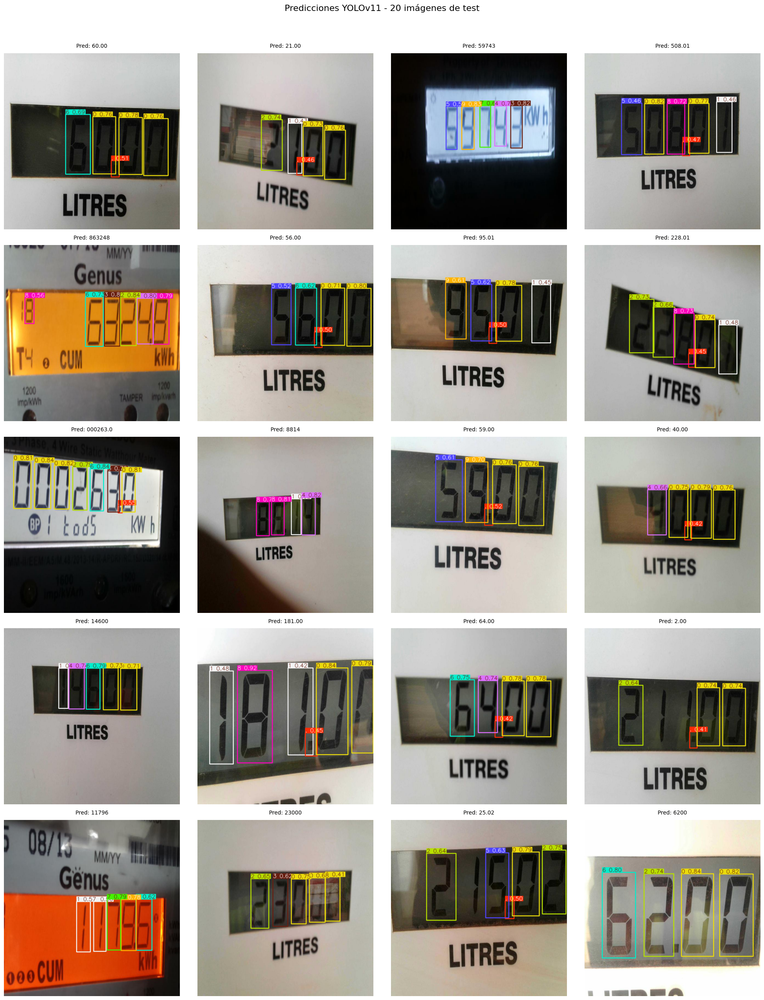

In [ ]:
# Configurar grid de resultados
n_cols = 4
n_rows = int(np.ceil(len(yolo_results) / n_cols))

plt.figure(figsize=(20, 5*n_rows))
plt.suptitle("Predicciones YOLOv11 - 20 imágenes de test", fontsize=16, y=1.02)

for i, result in enumerate(yolo_results):
    plt.subplot(n_rows, n_cols, i+1)

    if "annotated_image" in result:
        plt.imshow(result["annotated_image"])
        title = result["prediction"] if result["prediction"] else "No detection"
        plt.title(f"Pred: {title}", pad=10, color='black', fontsize=10)
        plt.axis('off')
    else:
        plt.text(0.5, 0.5, f"Error\n{result.get('error', '')[:30]}...",
                ha='center', va='center', color='red')
        plt.axis('off')

plt.tight_layout()
plt.show()